In [1]:
%cd C:\Users\valor\Desktop\Geoengine\GFZ\Code\Ref\Sen1Floods11\dataset

C:\Users\valor\Desktop\Geoengine\GFZ\Code\Ref\Sen1Floods11\dataset


In [2]:
LR = 5e-4
EPOCHS = 100
EPOCHS_PER_UPDATE = 1
RUNNAME = "Sen1Floods11"

import torch
import torchvision.models as models
import torch.nn as nn

net = models.segmentation.fcn_resnet50(pretrained=False, num_classes=2, pretrained_backbone=False)
net.backbone.conv1 = nn.Conv2d(2, 64, kernel_size=7, stride=2, padding=3, bias=False)

criterion = nn.CrossEntropyLoss(weight=torch.tensor([1,8]).float().cuda(), ignore_index=255) 
optimizer = torch.optim.AdamW(net.parameters(),lr=LR)
#scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, len(train_loader) * 10, T_mult=2, eta_min=0, last_epoch=-1)
def convertBNtoGN(module, num_groups=16):
  if isinstance(module, torch.nn.modules.batchnorm.BatchNorm2d):
    return nn.GroupNorm(num_groups, module.num_features,
                        eps=module.eps, affine=module.affine)
    if module.affine:
        mod.weight.data = module.weight.data.clone().detach()
        mod.bias.data = module.bias.data.clone().detach()

  for name, child in module.named_children():
      module.add_module(name, convertBNtoGN(child, num_groups=num_groups))

  return module

net = convertBNtoGN(net)

In [3]:
net.load_state_dict(torch.load('C:/Users/valor/Desktop/Geoengine/GFZ/Code/Test/Sen1Floods11/checkpoints/floodRes50_final200.pth')['model_state_dict'])
epochs=torch.load('C:/Users/valor/Desktop/Geoengine/GFZ/Code/Test/Sen1Floods11/checkpoints/floodRes50_final200.pth')['epoch']

net.eval()

FCN(
  (backbone): IntermediateLayerGetter(
    (conv1): Conv2d(2, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): GroupNorm(16, 64, eps=1e-05, affine=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): GroupNorm(16, 64, eps=1e-05, affine=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): GroupNorm(16, 64, eps=1e-05, affine=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): GroupNorm(16, 256, eps=1e-05, affine=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (1): GroupNorm(16, 256, eps=1e-05, affine=True)
        )
  

In [4]:
import torch
from torchvision import transforms
import torchvision.transforms.functional as F
import random
from PIL import Image

class InMemoryDataset(torch.utils.data.Dataset):
  
  def __init__(self, data_list, preprocess_func):
    self.data_list = data_list
    self.preprocess_func = preprocess_func
  
  def __getitem__(self, i):
    return self.preprocess_func(self.data_list[i])
  
  def __len__(self):
    return len(self.data_list)


def processTestIm(data):
  #print(type(data))
  (x,y) = data
  #print(type(x))
  im,label = x.copy(), y.copy()
  #print(type(im))
  norm = transforms.Normalize([0.6851, 0.5235], [0.0820, 0.1102])

  # convert to PIL for easier transforms
  im_c1 = Image.fromarray(im[0]).resize((512,512))
  im_c2 = Image.fromarray(im[1]).resize((512,512))
  label = Image.fromarray(label.squeeze()).resize((512,512))

 # im_c1s = [F.crop(im_c1, 0, 0, 256, 256), F.crop(im_c1, 0, 256, 256, 256),
 #          F.crop(im_c1, 256, 0, 256, 256), F.crop(im_c1, 256, 256, 256, 256)]
 # im_c2s = [F.crop(im_c2, 0, 0, 256, 256), F.crop(im_c2, 0, 256, 256, 256),
 #           F.crop(im_c2, 256, 0, 256, 256), F.crop(im_c2, 256, 256, 256, 256)]
 # labels = [F.crop(label, 0, 0, 256, 256), F.crop(label, 0, 256, 256, 256),
 #           F.crop(label, 256, 0, 256, 256), F.crop(label, 256, 256, 256, 256)]

  ims = [torch.stack((transforms.ToTensor()(im_c1).squeeze(),
                    transforms.ToTensor()(im_c2).squeeze()))
                    ]
  
  ims = [norm(im) for im in ims]
  ims = torch.stack(ims)
  
  labels = [(transforms.ToTensor()(label).squeeze())]
  labels = torch.stack(labels)
  
  if torch.sum(labels.gt(.003) * labels.lt(.004)):
    labels *= 255
  labels = labels.round()
  
  return ims, labels

In [5]:
from time import time
import csv
import os
import numpy as np
import rasterio

def getArrFlood(fname):
  return rasterio.open(fname).read()

def download_flood_water_data_from_list(l):
    i = 0
    tot_nan = 0
    tot_good = 0
    flood_data = []
    for (im_fname, mask_fname) in l:
        if not os.path.exists(im_fname):
            continue
        arr_x = np.nan_to_num(getArrFlood(im_fname))
        arr_y = getArrFlood(mask_fname)
        ignore = (arr_y == -1)
        ignore = ((np.uint8(ignore) * -1) * 256) + 1
        arr_y *= ignore
        arr_y = np.uint8(getArrFlood(mask_fname))
        if np.sum((arr_y != arr_y)) == 0:
            arr_x = np.clip(arr_x, -50, 1)
            arr_x = (arr_x + 50) / 51
      
        if i % 100 == 0:
            print(im_fname, mask_fname)
        i += 1
        flood_data.append((arr_x,arr_y))
    else:
        print("skipping nan")
    return flood_data

def load_flood_train_data(input_root, label_root):
  fname = "flood_train_data.csv"
  training_files = []
  with open(fname) as f:
    for line in csv.reader(f):
      training_files.append(tuple((input_root+line[0], label_root+line[1])))

  return download_flood_water_data_from_list(training_files)

def load_flood_valid_data(input_root, label_root):
  fname = "flood_valid_data.csv"
  validation_files = []
  with open(fname) as f:
    for line in csv.reader(f):
      validation_files.append(tuple((input_root+line[0], label_root+line[1])))

  return download_flood_water_data_from_list(validation_files)

def load_flood_test_data(input_root, label_root):
  fname = "test_India.csv"
  testing_files = []
  with open(fname) as f:
    for line in csv.reader(f):
      #print(line)
      testing_files.append(tuple((input_root+line[0], label_root+line[1])))
  
  return download_flood_water_data_from_list(testing_files)

In [6]:
%cd C:\Users\valor\Desktop\Geoengine\GFZ\Code\Ref\Sen1Floods11\dataset\v1.1\splits\flood_handlabeled
    
test_data = load_flood_test_data("C:\\Users\\valor\\Desktop\\Geoengine\\GFZ\\Code\\Ref\\Sen1Floods11\\dataset\\v1.1\\data\\flood_events\\HandLabeled\\S1Hand\\","C:\\Users\\valor\\Desktop\\Geoengine\\GFZ\\Code\\Ref\\Sen1Floods11\\dataset\\v1.1\\data\\flood_events\\HandLabeled\\LabelHand\\")
test_dataset = InMemoryDataset(test_data, processTestIm)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=1, shuffle=True, sampler=None,
                  batch_sampler=None, num_workers=0, collate_fn=lambda x: x[0],
                  pin_memory=True, drop_last=False, timeout=0,
                  worker_init_fn=None)


C:\Users\valor\Desktop\Geoengine\GFZ\Code\Ref\Sen1Floods11\dataset\v1.1\splits\flood_handlabeled
C:\Users\valor\Desktop\Geoengine\GFZ\Code\Ref\Sen1Floods11\dataset\v1.1\data\flood_events\HandLabeled\S1Hand\India_591317_S1Hand.tif C:\Users\valor\Desktop\Geoengine\GFZ\Code\Ref\Sen1Floods11\dataset\v1.1\data\flood_events\HandLabeled\LabelHand\India_591317_LabelHand.tif
skipping nan


In [7]:
from tqdm.auto import tqdm

def computeIOU(output, target):
  output = torch.argmax(output, dim=1).flatten() 
  target = target.flatten()
  
  no_ignore = target.ne(255).cuda()
  output = output.masked_select(no_ignore)
  target = target.masked_select(no_ignore)
  intersection = torch.sum(output * target)
  union = torch.sum(target) + torch.sum(output) - intersection
  iou = (intersection + .0000001) / (union + .0000001)
  
  if iou != iou:
    print("failed, replacing with 0")
    iou = torch.tensor(0).float()
  
  return iou
  
def computeAccuracy(output, target):
  output = torch.argmax(output, dim=1).flatten() 
  target = target.flatten()
  
  no_ignore = target.ne(255).cuda()
  output = output.masked_select(no_ignore)
  target = target.masked_select(no_ignore)
  correct = torch.sum(output.eq(target))
  
  return correct.float() / len(target)

def truePositives(output, target):
  output = torch.argmax(output, dim=1).flatten() 
  target = target.flatten()
  no_ignore = target.ne(255).cuda()
  output = output.masked_select(no_ignore)
  target = target.masked_select(no_ignore)
  correct = torch.sum(output * target)
  return correct

def trueNegatives(output, target):
  output = torch.argmax(output, dim=1).flatten() 
  target = target.flatten()
  no_ignore = target.ne(255).cuda()
  output = output.masked_select(no_ignore)
  target = target.masked_select(no_ignore)
  output = (output == 0)
  target = (target == 0)
  correct = torch.sum(output * target)
  return correct

def falsePositives(output, target):
  output = torch.argmax(output, dim=1).flatten() 
  target = target.flatten()
  no_ignore = target.ne(255).cuda()
  output = output.masked_select(no_ignore)
  target = target.masked_select(no_ignore)
  output = (output == 1)
  target = (target == 0)
  correct = torch.sum(output * target)
  return correct

def falseNegatives(output, target):
  output = torch.argmax(output, dim=1).flatten() 
  target = target.flatten()
  no_ignore = target.ne(255).cuda()
  output = output.masked_select(no_ignore)
  target = target.masked_select(no_ignore)
  output = (output == 0)
  target = (target == 1)
  correct = torch.sum(output * target)
  return correct

def test_loop(test_data_loader, net):
  net = net.eval()
  net = net.cuda()
  count = 0
  iou = 0
  loss = 0
  accuracy = 0
  tp = 0
  fp = 0
  tn = 0
  fn = 0
  with torch.no_grad():
      for (images, labels) in tqdm(test_data_loader):
          net = net.cuda()
          outputs = net(images.cuda())
          valid_iou = computeIOU(outputs["out"], labels.cuda())
          iou += valid_iou
          accuracy += computeAccuracy(outputs["out"], labels.cuda())
          tp +=  truePositives(outputs["out"], labels.cuda())
          fp +=  falsePositives(outputs["out"], labels.cuda())
          tn +=  trueNegatives(outputs["out"], labels.cuda())
          fn +=  falseNegatives(outputs["out"], labels.cuda())
          count += 1

  iou = iou / count
  print("Test Mean IOU:", iou)
  print("Total IOU:", (tp.float() / (fn + fp + tp)))
  print("OMISSON:", fn.float() / (fn + tp))
  print("COMMISSON:", fp.float() / (tn + fp))
  print("Test Accuracy:", accuracy / count)


In [8]:
test_loop(test_loader, net)

  0%|          | 0/13 [00:00<?, ?it/s]

C:\Users\valor\anaconda3\envs\torch\lib\site-packages\torchvision\transforms\functional.py:92: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ..\torch\csrc\utils\tensor_numpy.cpp:141.)
  img = torch.from_numpy(np.array(pic, np.float32, copy=False))


Test Mean IOU: tensor(0.3851, device='cuda:0')
Total IOU: tensor(0.5524, device='cuda:0')
OMISSON: tensor(0.1260, device='cuda:0')
COMMISSON: tensor(0.1370, device='cuda:0')
Test Accuracy: tensor(0.8554, device='cuda:0')


  0%|          | 0/13 [00:00<?, ?it/s]

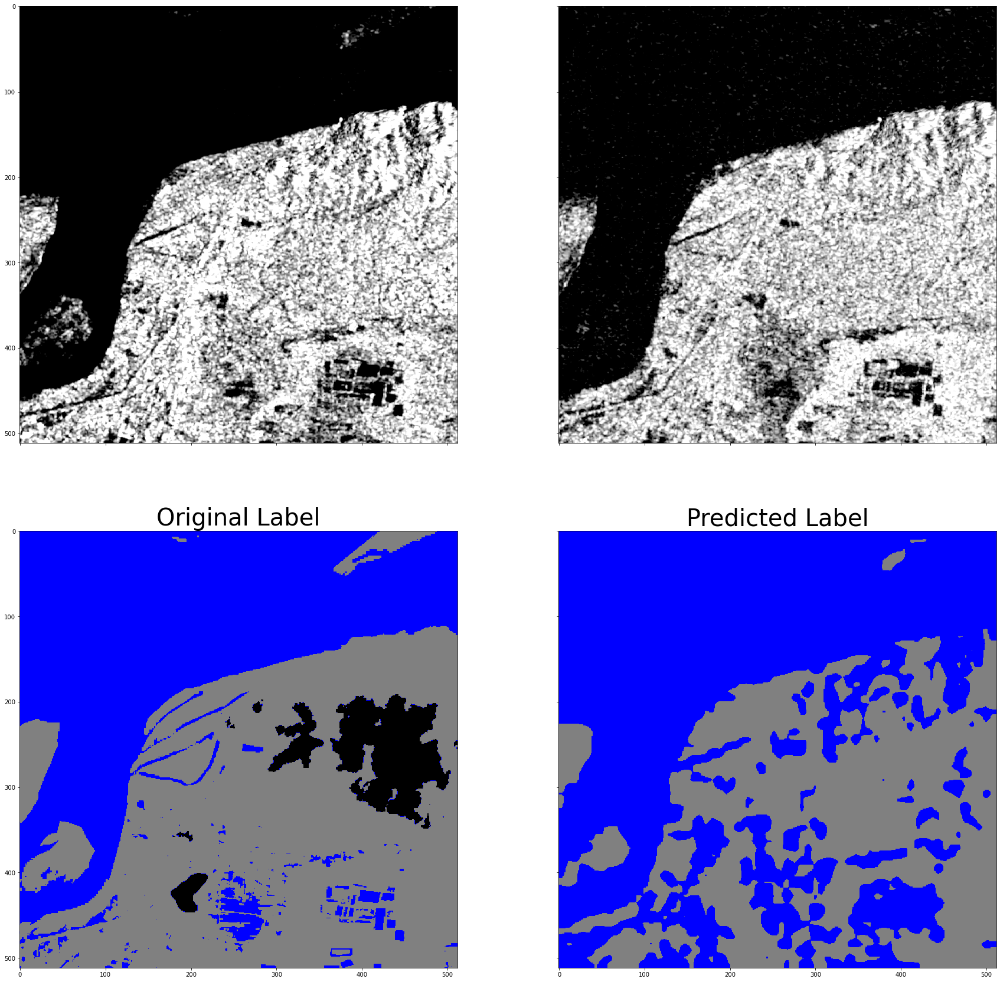

confusion matix: [[89307, 1869, 13230], [42703, 112170, 2865], [0, 0, 0]]
valid iou: tensor(0.7156, device='cuda:0')
accuracy : tensor(0.8188, device='cuda:0')
true positive: tensor(112170., device='cuda:0')
fales positive: tensor(42703, device='cuda:0')
true negative: tensor(89307, device='cuda:0')
false negative: tensor(1869, device='cuda:0')
OMISSON: tensor(0.0164, device='cuda:0')
COMMISSON: tensor(0.3235, device='cuda:0')


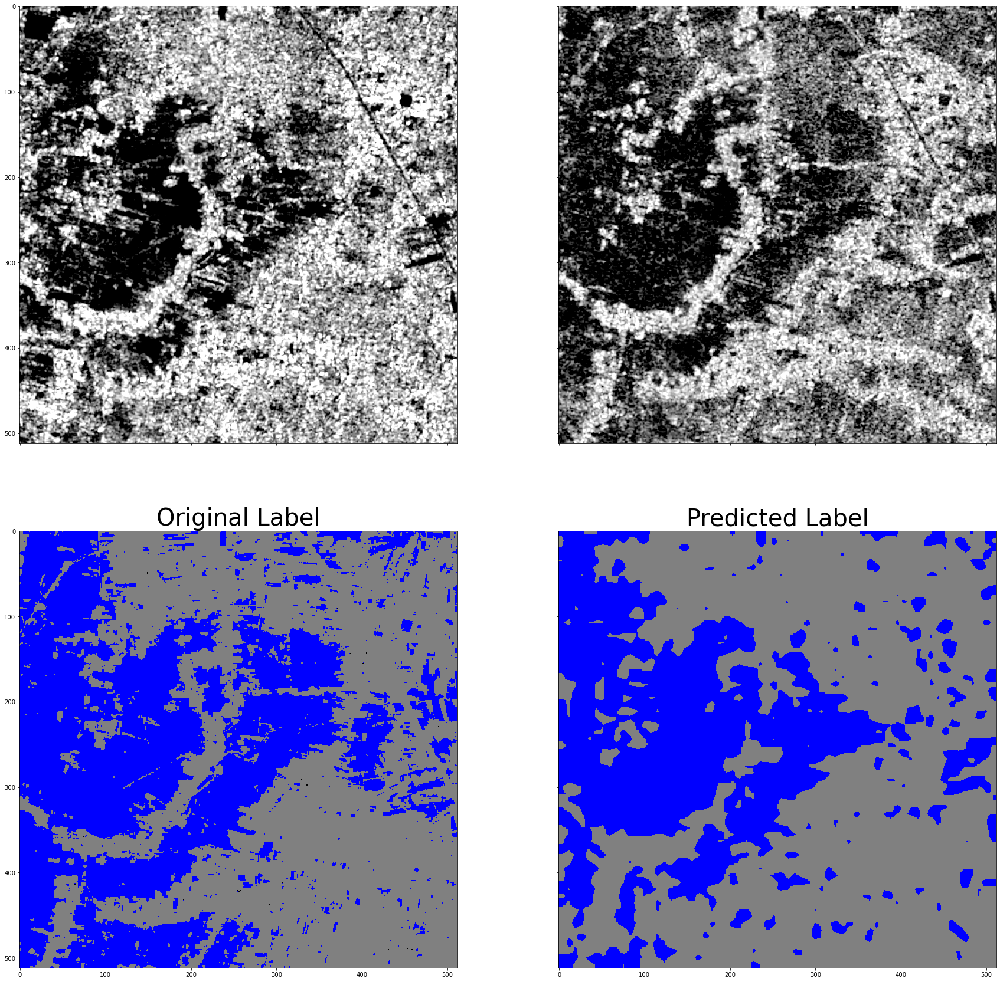

confusion matix: [[129439, 39328, 57], [15326, 77994, 0], [0, 0, 0]]
valid iou: tensor(0.5880, device='cuda:0')
accuracy : tensor(0.7915, device='cuda:0')
true positive: tensor(77994., device='cuda:0')
fales positive: tensor(15326, device='cuda:0')
true negative: tensor(129439, device='cuda:0')
false negative: tensor(39328, device='cuda:0')
OMISSON: tensor(0.3352, device='cuda:0')
COMMISSON: tensor(0.1059, device='cuda:0')


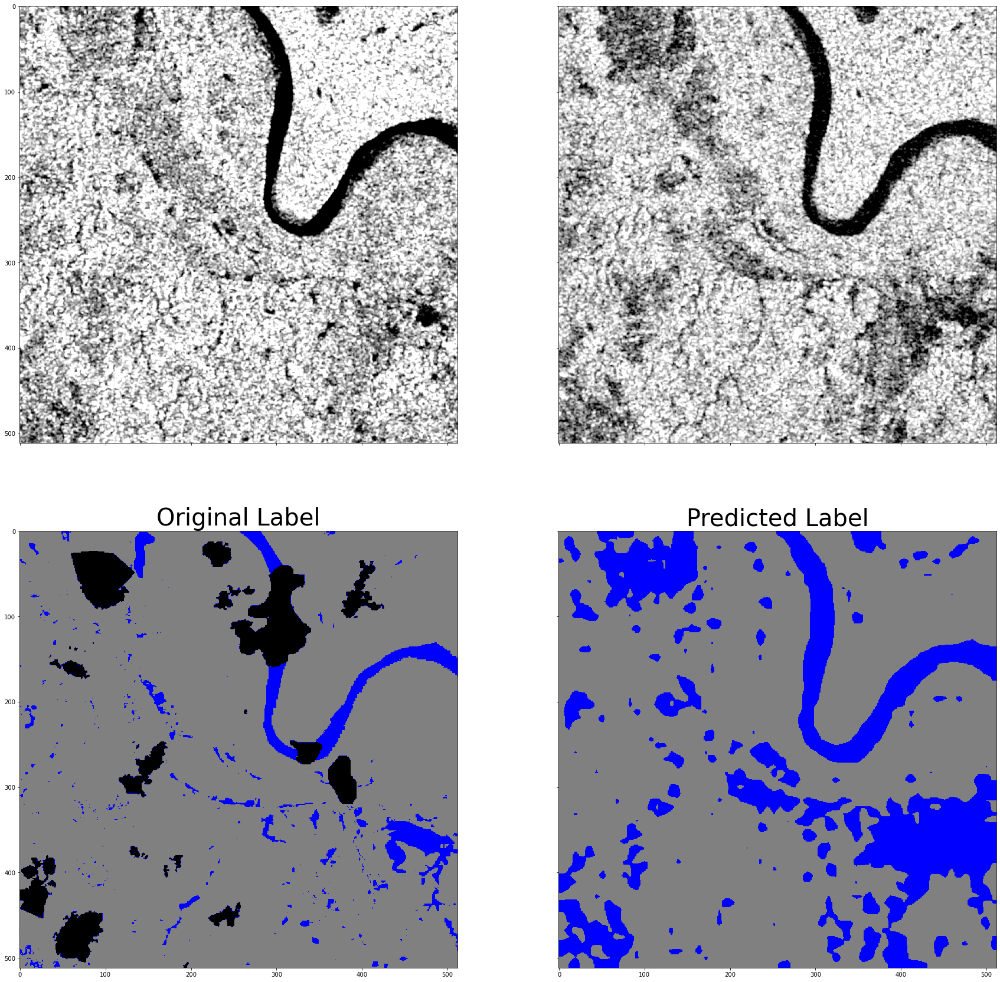

confusion matix: [[190527, 1655, 10803], [36925, 12893, 9341], [0, 0, 0]]
valid iou: tensor(0.2505, device='cuda:0')
accuracy : tensor(0.8406, device='cuda:0')
true positive: tensor(12893., device='cuda:0')
fales positive: tensor(36925, device='cuda:0')
true negative: tensor(190527, device='cuda:0')
false negative: tensor(1655, device='cuda:0')
OMISSON: tensor(0.1138, device='cuda:0')
COMMISSON: tensor(0.1623, device='cuda:0')


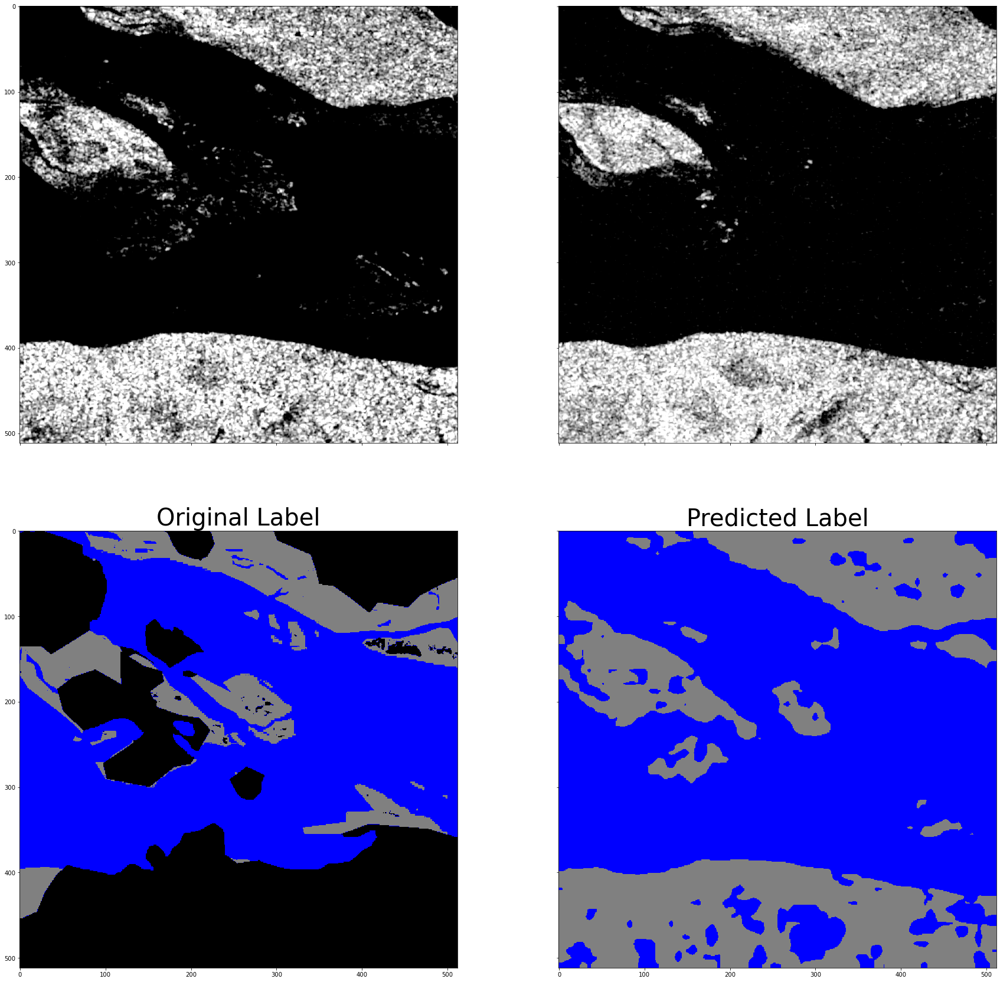

confusion matix: [[24774, 1165, 67541], [12513, 113341, 42810], [0, 0, 0]]
valid iou: tensor(0.8923, device='cuda:0')
accuracy : tensor(0.9099, device='cuda:0')
true positive: tensor(113341., device='cuda:0')
fales positive: tensor(12513, device='cuda:0')
true negative: tensor(24774, device='cuda:0')
false negative: tensor(1165, device='cuda:0')
OMISSON: tensor(0.0102, device='cuda:0')
COMMISSON: tensor(0.3356, device='cuda:0')


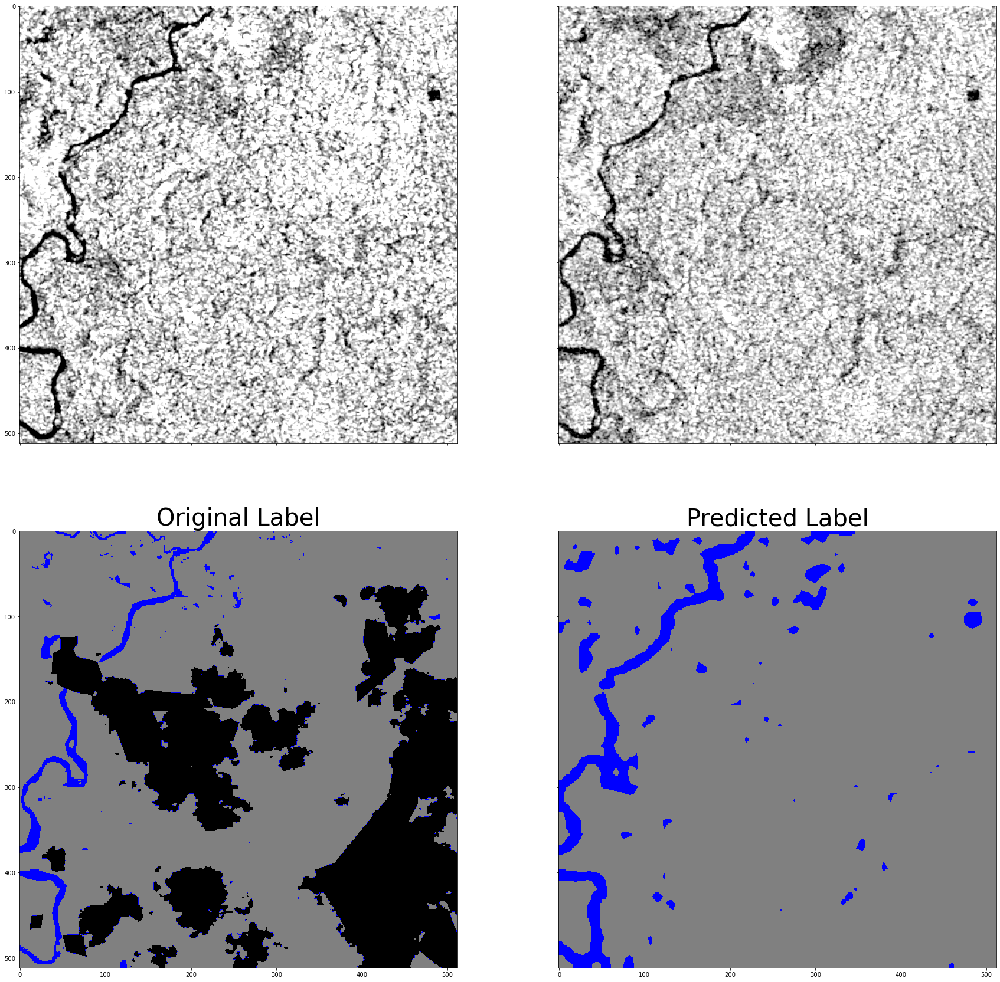

confusion matix: [[167122, 1073, 77986], [9004, 5921, 1038], [0, 0, 0]]
valid iou: tensor(0.3701, device='cuda:0')
accuracy : tensor(0.9450, device='cuda:0')
true positive: tensor(5921., device='cuda:0')
fales positive: tensor(9004, device='cuda:0')
true negative: tensor(167122, device='cuda:0')
false negative: tensor(1073, device='cuda:0')
OMISSON: tensor(0.1534, device='cuda:0')
COMMISSON: tensor(0.0511, device='cuda:0')


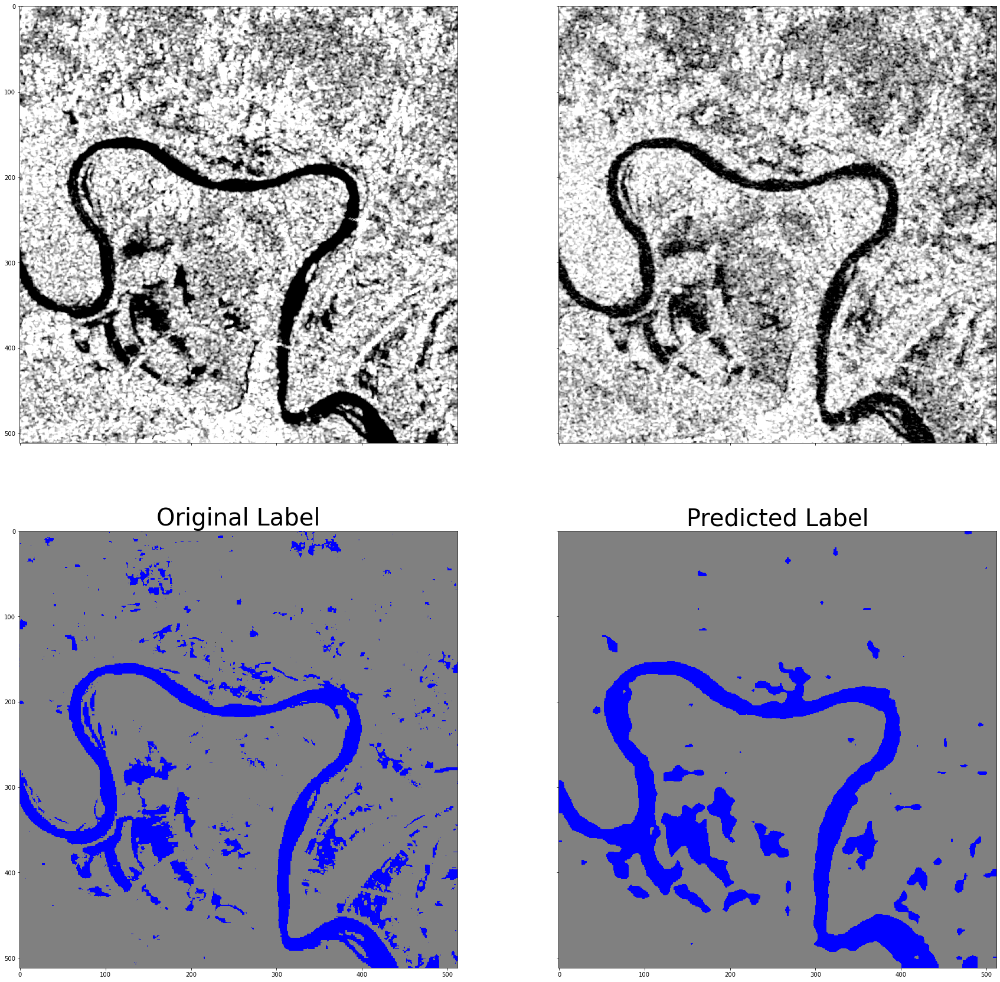

confusion matix: [[215811, 10972, 2], [9682, 25677, 0], [0, 0, 0]]
valid iou: tensor(0.5542, device='cuda:0')
accuracy : tensor(0.9212, device='cuda:0')
true positive: tensor(25677., device='cuda:0')
fales positive: tensor(9682, device='cuda:0')
true negative: tensor(215811, device='cuda:0')
false negative: tensor(10972, device='cuda:0')
OMISSON: tensor(0.2994, device='cuda:0')
COMMISSON: tensor(0.0429, device='cuda:0')


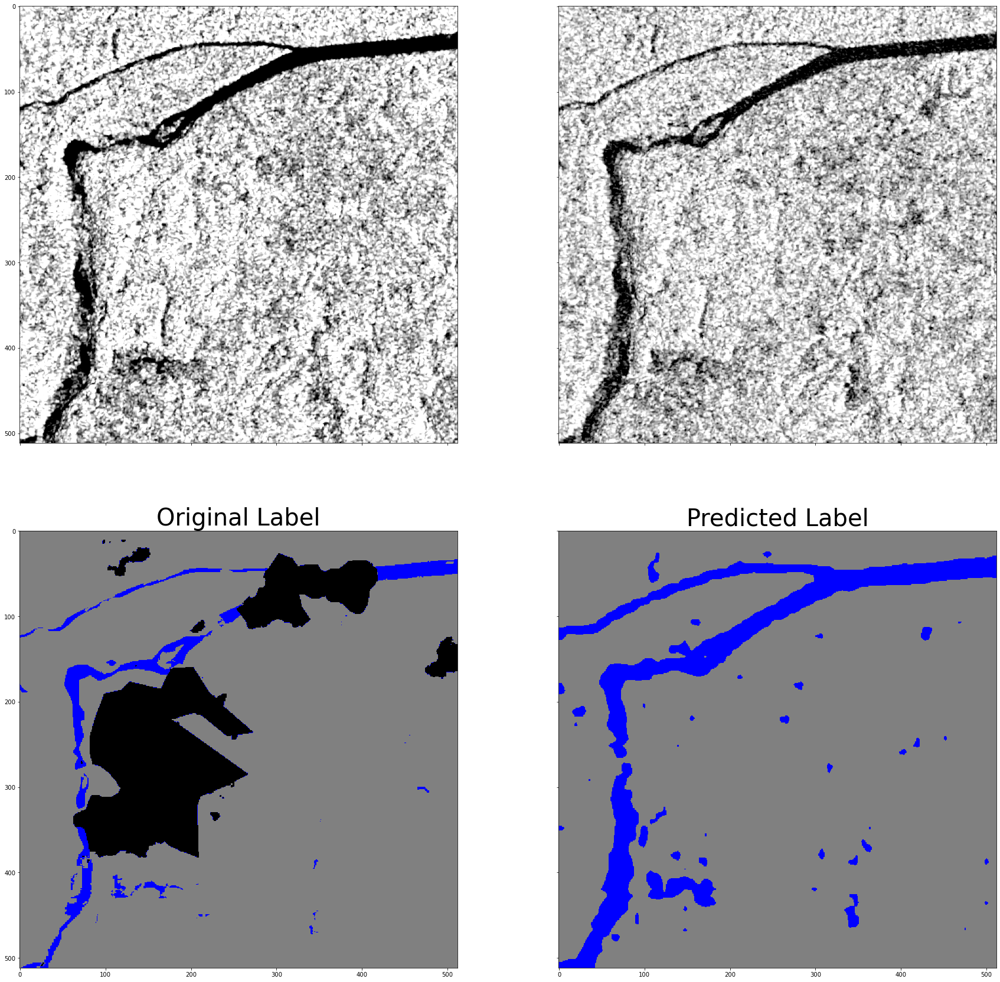

confusion matix: [[202851, 365, 32257], [12460, 8679, 5532], [0, 0, 0]]
valid iou: tensor(0.4036, device='cuda:0')
accuracy : tensor(0.9428, device='cuda:0')
true positive: tensor(8679., device='cuda:0')
fales positive: tensor(12460, device='cuda:0')
true negative: tensor(202851, device='cuda:0')
false negative: tensor(365, device='cuda:0')
OMISSON: tensor(0.0404, device='cuda:0')
COMMISSON: tensor(0.0579, device='cuda:0')


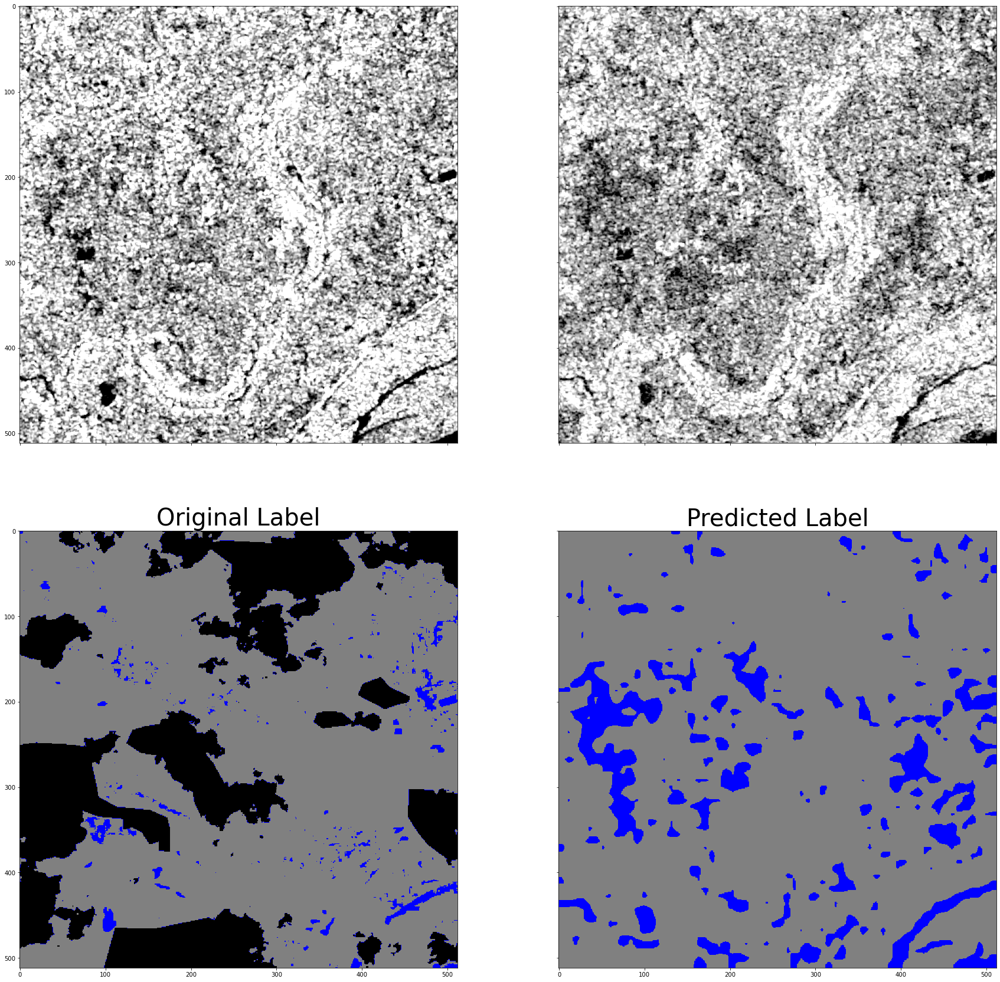

confusion matix: [[163822, 2517, 63813], [19046, 3331, 9615], [0, 0, 0]]
valid iou: tensor(0.1338, device='cuda:0')
accuracy : tensor(0.8857, device='cuda:0')
true positive: tensor(3331., device='cuda:0')
fales positive: tensor(19046, device='cuda:0')
true negative: tensor(163822, device='cuda:0')
false negative: tensor(2517, device='cuda:0')
OMISSON: tensor(0.4304, device='cuda:0')
COMMISSON: tensor(0.1042, device='cuda:0')


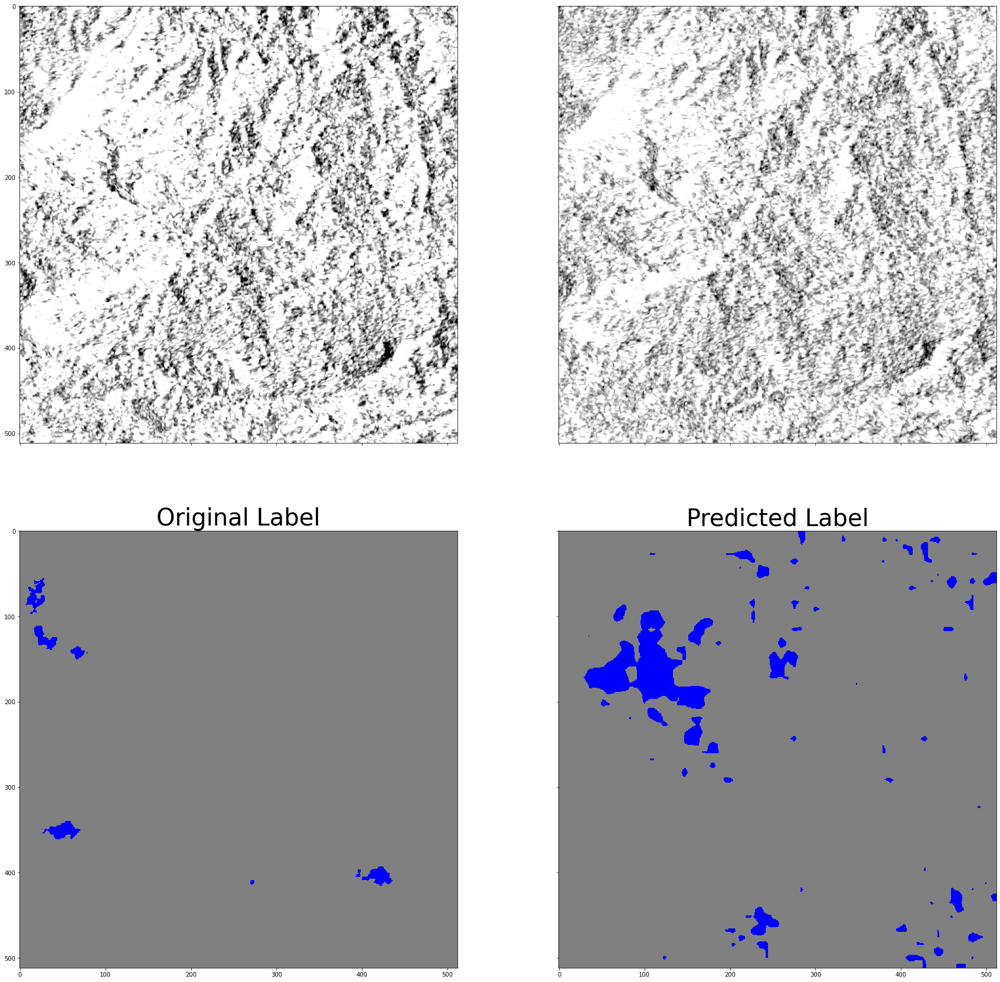

confusion matix: [[248015, 1922], [12160, 47]]
valid iou: tensor(0.0033, device='cuda:0')
accuracy : tensor(0.9463, device='cuda:0')
true positive: tensor(47., device='cuda:0')
fales positive: tensor(12160, device='cuda:0')
true negative: tensor(248015, device='cuda:0')
false negative: tensor(1922, device='cuda:0')
OMISSON: tensor(0.9761, device='cuda:0')
COMMISSON: tensor(0.0467, device='cuda:0')


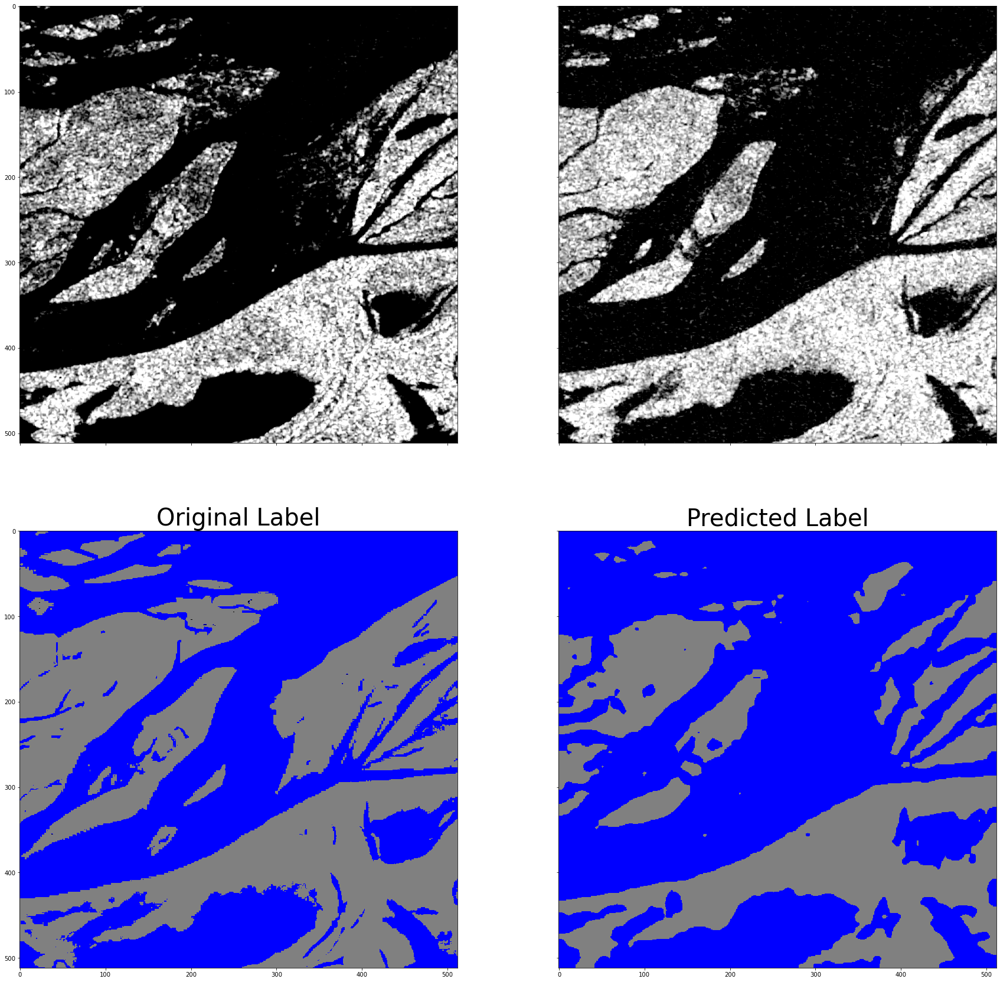

confusion matix: [[85426, 6555, 3], [40401, 129737, 22], [0, 0, 0]]
valid iou: tensor(0.7343, device='cuda:0')
accuracy : tensor(0.8209, device='cuda:0')
true positive: tensor(129737., device='cuda:0')
fales positive: tensor(40401, device='cuda:0')
true negative: tensor(85426, device='cuda:0')
false negative: tensor(6555, device='cuda:0')
OMISSON: tensor(0.0481, device='cuda:0')
COMMISSON: tensor(0.3211, device='cuda:0')


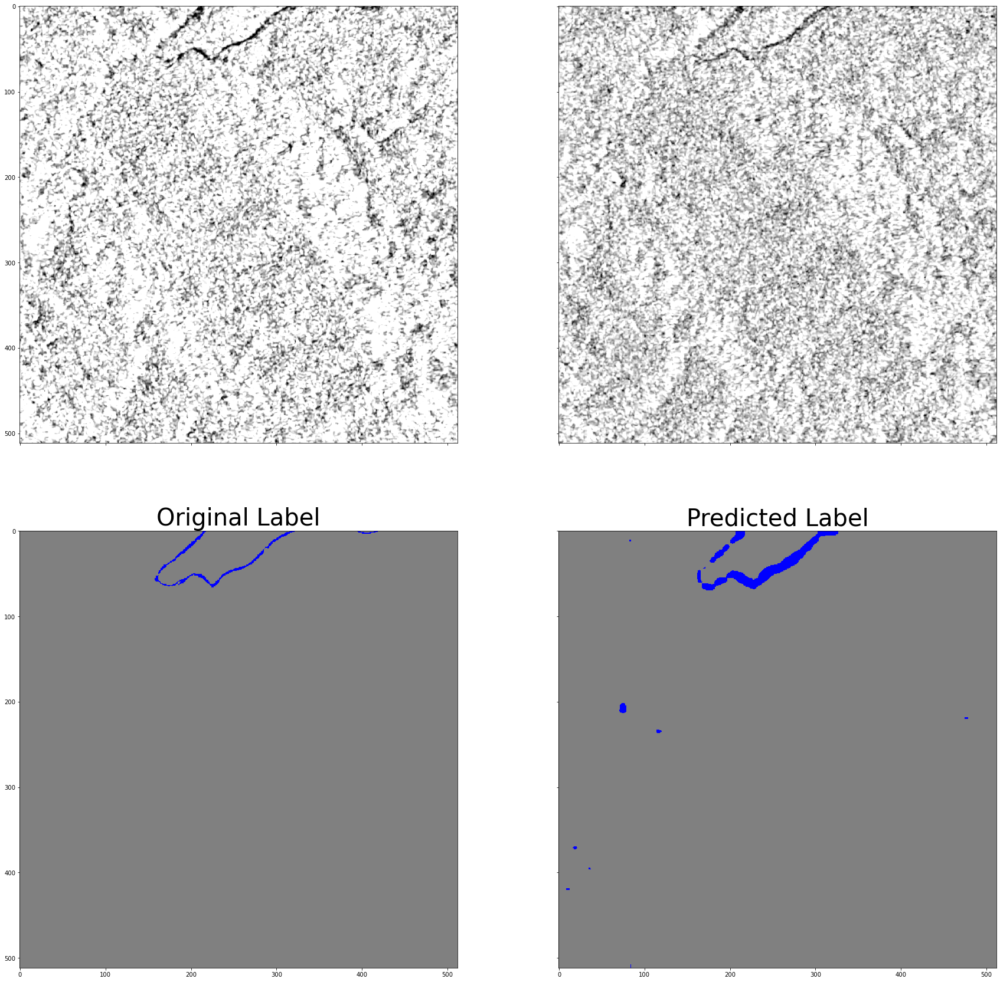

confusion matix: [[259852, 143], [1490, 659]]
valid iou: tensor(0.2875, device='cuda:0')
accuracy : tensor(0.9938, device='cuda:0')
true positive: tensor(659., device='cuda:0')
fales positive: tensor(1490, device='cuda:0')
true negative: tensor(259852, device='cuda:0')
false negative: tensor(143, device='cuda:0')
OMISSON: tensor(0.1783, device='cuda:0')
COMMISSON: tensor(0.0057, device='cuda:0')


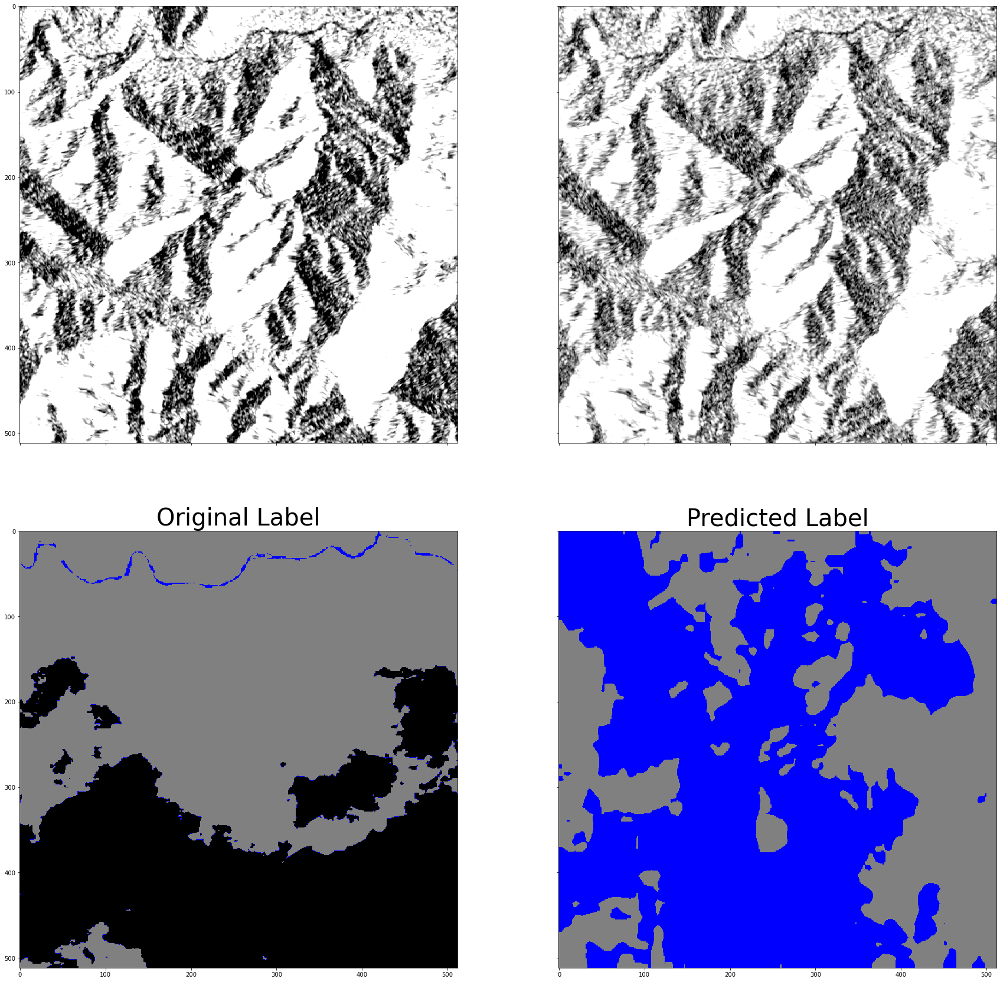

confusion matix: [[64619, 519, 44219], [89368, 826, 62593], [0, 0, 0]]
valid iou: tensor(0.0091, device='cuda:0')
accuracy : tensor(0.4213, device='cuda:0')
true positive: tensor(826., device='cuda:0')
fales positive: tensor(89368, device='cuda:0')
true negative: tensor(64619, device='cuda:0')
false negative: tensor(519, device='cuda:0')
OMISSON: tensor(0.3859, device='cuda:0')
COMMISSON: tensor(0.5804, device='cuda:0')


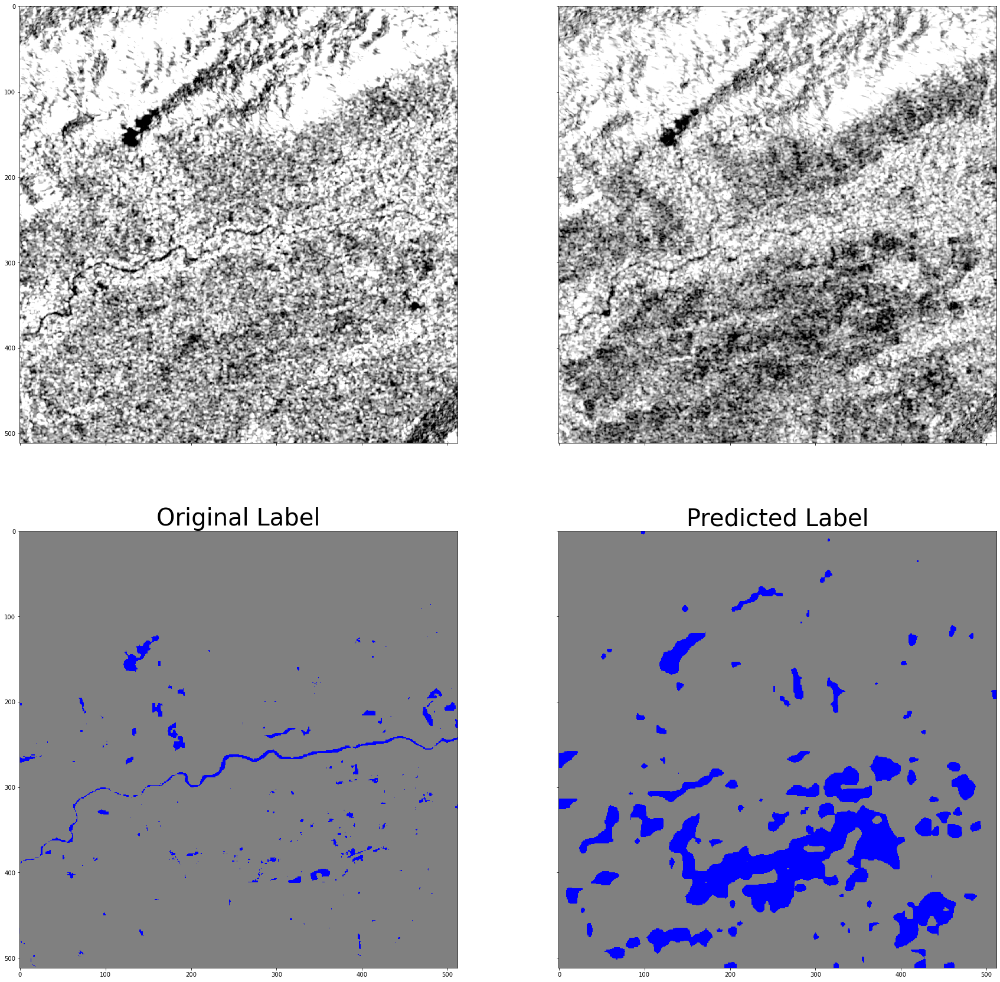

confusion matix: [[229347, 3056], [27632, 2109]]
valid iou: tensor(0.0643, device='cuda:0')
accuracy : tensor(0.8829, device='cuda:0')
true positive: tensor(2109., device='cuda:0')
fales positive: tensor(27632, device='cuda:0')
true negative: tensor(229347, device='cuda:0')
false negative: tensor(3056, device='cuda:0')
OMISSON: tensor(0.5917, device='cuda:0')
COMMISSON: tensor(0.1075, device='cuda:0')


In [11]:
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
from torchvision.utils import save_image
savenames=['India_900498_','India_591317_','India_747992_','India_79637_','India_952728_','India_828067_','India_570384_','India_44475_','India_80221_','India_1018327_','India_592446_','India_772630_','India_631692_','India_399883_']


def confusionmatrix(actual, predicted, normalize = False):
    unique = sorted(set(actual))
    matrix = [[0 for _ in unique] for _ in unique]
    imap   = {key: i for i, key in enumerate(unique)}
    # Generate Confusion Matrix
    for p, a in zip(predicted, actual):
        matrix[imap[p]][imap[a]] += 1
    # Matrix Normalization
    if normalize:
        sigma = sum([sum(matrix[imap[i]]) for i in unique])
        matrix = [row for row in map(lambda i: list(map(lambda j: j / sigma, i)), matrix)]
    return matrix
id=0

for (images, labels) in tqdm(test_loader,leave=False):
    output = net(images.cuda())
    
     
    tp =  truePositives(output["out"], labels.cuda())
    fp =  falsePositives(output["out"], labels.cuda())
    tn =  trueNegatives(output["out"], labels.cuda())
    fn =  falseNegatives(output["out"], labels.cuda())


    #print(output)
    out = torch.argmax(output["out"], dim=1)
    savenam=savenames[id]
    save_image(out.float(), "C:\\Users\\valor\\Desktop\\Geoengine\\GFZ\\Code\\Test\\Sen1Floods11\\"+savenam+'predicted.tif')
#out1 = torch.cat((output[0,:,:], output[1,:,:]), 1)
#out2 = torch.cat((output[2,:,:], output[3,:,:]), 1)
#out = torch.cat((out1, out2), 0)


    #print(out.size())

#torch.histc(out)
# histogram
    #plt.hist(out.cpu().detach().numpy().flatten(), bins=100, range=(0.0, 1.0), fc='k', ec='k')
    # display test images

    (x,y) = images.numpy().squeeze(),labels.numpy().squeeze()
    im,label = x.copy(), y.copy()
    cmap1=mpl.colors.ListedColormap(['gray','blue','black'],N=3)
    cmap2=mpl.colors.ListedColormap(['black','gray','blue'])
    label=np.clip(label,-1,2)
    fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(30, 30), sharex=True, sharey=True)
    ax[0][0].imshow(im[0,:,:],cmap='gray',vmin=0,vmax=2)
    ax[0][1].imshow(im[1,:,:],cmap='gray',vmin=0,vmax=2)
    ax[1][0].imshow(label,cmap=cmap1,vmin=0,vmax=2)
    ax[1][0].set_title('Original Label', fontsize=40)
    ax[1][1].imshow(out.squeeze().cpu(),cmap=cmap2,vmin=-1,vmax=1)
    ax[1][1].set_title('Predicted Label', fontsize=40)
    
    #print(np.unique(label))
    plt.show() 
    Pre=out.squeeze().cpu().numpy().reshape(1,512*512)
    Tru=label.squeeze().reshape(1,512*512)
    cm=confusionmatrix(Tru[0],Pre[0])
    #print(im)
    print('confusion matix:',cm)
        
    print('valid iou:',computeIOU(output["out"], labels.cuda()))
    print('accuracy :',computeAccuracy(output["out"], labels.cuda()))
    print('true positive:',tp)
    print('fales positive:',fp)
    print('true negative:',tn)
    print('false negative:',fn)
    print("OMISSON:", fn.float() / (fn + tp))
    print("COMMISSON:", fp.float() / (tn + fp))
    print('=======')
    id+=1

In [ ]:
from torchvision.utils import save_image

# For single image testing
(x,y) = test_data[-1]
im,label = x.copy(), y.copy()
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(30, 30), sharex=True, sharey=True)
ax[0].imshow(im[0],cmap='gray',vmin=0.5,vmax=1)
ax[1].imshow(im[1],cmap='gray',vmin=0.5,vmax=1)

output = net(tensor(im))
out = torch.argmax(output["out"], dim=1)
cmap1=mpl.colors.ListedColormap(['black','black','blue'])
cmap2=mpl.colors.ListedColormap(['gray','black','blue'])
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(30, 30), sharex=True, sharey=True)
ax[1].imshow(out.squeeze().cpu().numpy(),cmap=cmap2,vmin=-1,vmax=1)
ax[1].set_title('Predicted Label', fontsize=30)
ax[0].imshow(label.squeeze(),cmap=cmap1,vmin=-1,vmax=2)
ax[0].set_title('Original Label', fontsize=30)


save_name="predicted_India_952728"+str(125)+".tif"
save_image(out.float(), "C:\\Users\\valor\\Desktop\\Geoengine\\GFZ\\Code\\Test\\Sen1Floods11\\"+save_name)

Pre=out.squeeze().cpu().numpy().reshape(1,512*512)
Tru=label.squeeze().reshape(1,512*512)

def confusionmatrix(actual, predicted, normalize = False):
    """
    Generate a confusion matrix for multiple classification
    @params:
        actual      - a list of integers or strings for known classes
        predicted   - a list of integers or strings for predicted classes
        normalize   - optional boolean for matrix normalization
    @return:
        matrix      - a 2-dimensional list of pairwise counts
    """
    unique = sorted(set(actual))
    matrix = [[0 for _ in unique] for _ in unique]
    imap   = {key: i for i, key in enumerate(unique)}
    # Generate Confusion Matrix
    for p, a in zip(predicted, actual):
        matrix[imap[p]][imap[a]] += 1
    # Matrix Normalization
    if normalize:
        sigma = sum([sum(matrix[imap[i]]) for i in unique])
        matrix = [row for row in map(lambda i: list(map(lambda j: j / sigma, i)), matrix)]
    return matrix
cm=confusionmatrix(Tru[0],Pre[0])